 Mask R-CNN + FCN - Test on COCO Dataset

Run the Mask R-CNN net in inference mode, with the additional PCILayer that generates the context-based tensor 

# Setup Pipeline -  (build model and load weights)

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
    
import numpy as np
import mrcnn.utils     as utils
import mrcnn.visualize as visualize

from mrcnn.prep_notebook import  build_mrcnn_inference_pipeline, run_mrcnn_inference_pipeline,run_mrcnn_detection
from mrcnn.prep_notebook import build_fcn_inference_pipeline, run_fcn_inference_pipeline, run_fcn_detection
from mrcnn.visualize     import display_training_batch
from mrcnn.prep_notebook import get_prediction_batch, get_image_batch, get_training_batch
from mrcnn.coco          import prep_coco_dataset
from mrcnn.datagen import data_gen_simulate

input_parms  =" --batch_size     1  "
input_parms +=" --lr 0.00001     --val_steps 8 " 
input_parms +=" --mrcnn_logs_dir train_mrcnn_coco "
input_parms +=" --fcn_logs_dir   train_fcn8_subset " 
input_parms +=" --mrcnn_model    last "
input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "
input_parms +=" --sysout         screen "
input_parms +=" --fcn_arch       fcn8 " 
# input_parms = " --epochs         2   --steps_in_epoch 32  --last_epoch 0 "
# input_parms +=" --fcn_model      init "
input_parms +=" --opt            adam "
# input_parms +=" --fcn_layers     all " 
# input_parms +=" --coco_classes   62 63 67 78 79 80 81 82 72 73 74 75 76 77"
# input_parms +=" --new_log_folder    "

parser = utils.command_line_parser()
args = parser.parse_args(input_parms.split())
print(args)

Current working dir:  E:\git_projs\MRCNN3\notebooks
appending '..' to sys.path


Using TensorFlow backend.


Namespace(batch_size='1', coco_classes=[78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15], epochs=1, fcn_arch='FCN8', fcn_layers='fcn32+', fcn_logs_dir='train_fcn8_subset', fcn_model='last', last_epoch=0, lr='0.00001', mrcnn_exclude_layers=None, mrcnn_logs_dir='train_mrcnn_coco', mrcnn_model='last', new_log_folder=False, opt='ADAM', scale_factor=4, steps_in_epoch=1, sysout='SCREEN', val_steps='8')


In [2]:
mrcnn_model, fcn_model = build_fcn_inference_pipeline(args = args,verbose = 0)


--> Execution started at: 12-03-2018 @ 15:20:46
    Tensorflow Version: 1.8.0   Keras Version : 2.2.0 
>>> Initialize Paths
 windows  Windows

Paths:
-------------------------
COCO_DATASET_PATH              F:\MLDatasets\coco2014
COCO_HEATMAP_PATH              F:\MLDatasets\coco2014_heatmaps
COCO_MODEL_PATH                F:\PretrainedModels\mask_rcnn_coco.h5
DIR_DATASET                    F:\MLDatasets
DIR_PRETRAINED                 F:\PretrainedModels
DIR_ROOT                       F:\
DIR_TRAINING                   F:\models
FCN_TRAINING_PATH              F:\models\train_fcn8_subset
FCN_VGG16_MODEL_PATH           F:\PretrainedModels\fcn_vgg16_weights_tf_dim_ordering_tf_kernels.h5
MRCNN_TRAINING_PATH            F:\models\train_mrcnn_coco
RESNET_MODEL_PATH              F:\PretrainedModels\resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5
VGG16_MODEL_PATH               F:\PretrainedModels\vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5


>>> Initialize ModelBase model 
   Mode   

   --- FCN16 ----------------------------
   FCN scorePool4 (Conv2D(Pool4)) shape is                   :  (None, 16, 16, 81)    keras_tensor  True
   FCN 2x Upsampling (Deconvolution2D(fcn32_classify)) shape :  (None, 18, 18, 81)    keras_tensor  True
   FCN 2x Upsampling/Cropped (Cropped2D(score2)) shape       :  (None, 16, 16, 81)    keras_tensor  True
   FCN Add Score2,scorePool4 Add(score2_c, scorePool4) shape :  (None, 16, 16, 81)    keras_tensor  True
   FCN upscore_pool4 (Deconv(fuse_Pool4)) shape              :  (None, 32, 32, 81)    keras_tensor  True

   --- FCN8 ----------------------------
   FCN scorePool4 (Conv2D(Pool4)) shape                      :  (None, 32, 32, 81)    keras_tensor  True
   FCN 2x Upsampling/Cropped (Cropped2D(score2)) shape       :  (None, 32, 32, 81)    keras_tensor  True
   FCN Add Score2,scorePool4 shape is                        :  (None, 32, 32, 81)    keras_tensor  True

   FCN fcn8_classify/heatmap  (Deconv(fuse_Pool4)) shape:  (?, 256, 256, 81

    seq_ids                        :  shape: (?,)                  KB.shape:(None,)               Keras Tensor: False
    sscatter_ids                   :  shape: (?, 2)                KB.shape:(None, 2)             Keras Tensor: False
    fcn_scores_by_class            :  shape: (1, 81, 200, 23)      KB.shape:(1, 81, 200, 23)      Keras Tensor: False
    fcn_scores_by_image            :  shape: (1, 200, 23)          KB.shape:(1, 200, 23)          Keras Tensor: False
complete
 self.keras_model.losses :  0

>>> FCN build complete. mode:  inference
>>> FCN initialization complete. mode:  inference

 MRCNN IO Layers 
 --------------- 
 Inputs:
 -------
 index:  0    input name : input_image:0                              Type: float32           Shape: (?, 1024, 1024, 3)
 index:  1    input name : input_image_meta:0                         Type: float32           Shape: (?, ?)
 Outputs:
 --------
 layer:  0    output name: mrcnn_detection/PyFunc:0                   Type: float32           

###  Print some information about the model 

In [ ]:
# for layer in model.keras_model.layers
#     print layer.name 

layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print(len(layers))

for idx in range(200, len(layers)):
    print( ' layer: {} name: {}'.format(idx, layers[idx].name))
#     print(' layer {} :  {}'.format(idx,layers[idx]))
#     print(' Number of inbound nodes: ', end ='')
#     pp.pprint(len(layers[idx]._inbound_nodes))
#     pp.pprint(layers[idx].__dict__)
#     print('-------------------------------------------')
print('idx : ', idx)
pp.pprint(layers[idx].__dict__)

print()
pp.pprint(layers[idx]._inbound_nodes[0].__dict__)

####  Print Layer & Weight Info

In [ ]:
# keras_model = mrcnn_model.keras_model
# layers = keras_model.inner_model.layers if hasattr(keras_model, "inner_model") else keras_model.layers
# print(dir(layers[0]))
# pp.pprint(layers[7].weights)
print()
for i in range(len(layers)):
    print('\n{:3d} {:20s} Weights: {}'.format(i, layers[i].name, len(layers[i].weights))) ## [weight.name for weight in layers[i].weights]))
    print('{:23s}  Trainable: {} '.format(' ',[weight.name for weight in layers[i].trainable_weights]))
    for weight in layers[i].weights:
        print('{:25s} {:30s} {}  '.format(' ',weight.name,  weight.shape))

####  More layer information

In [ ]:
import pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
np.set_printoptions(linewidth=100,precision=4,threshold=1000, suppress = True)

# model.compile_only(learning_rate=config.LEARNING_RATE, layers='heads')
# print('\n Metrics (_get_deduped_metrics_names():) ') 
# pp.pprint(mm._get_deduped_metrics_names())
# print('\n Losses (model.metrics_names): ') 
# pp.pprint(mm.metrics_names)
# KB.set_learning_phase(0)
# print(' Learning phase values is L ' ,KB.learning_phase())
# print('\Layers ', len(mrcnn_model.keras_model.layers))
# pp.pprint(mrcnn_model.keras_model.layers)

print('\n Weights: ') 
## Get weieights acturally returns weight dims
# print(' Number of weights arrays: ',len(mrcnn_model.keras_model.get_weights()))
print(' length of model.keras_model.weights', len(mrcnn_model.keras_model.weights))
# for i,j in enumerate(mrcnn_model.keras_model.weights):
#     print(i, j) # j.name, j.shape, j.dtype)
# pp.pprint(mrcnn_model.keras_model.weights)
# pp.pprint(type(mrcnn_model.keras_model.get_weights()))

# pp.pprint(dir(model.keras_model))
# print(mrcnn_model.keras_model.weights[1])

#### List trainable layers using `get_trainable_layers()`

In [ ]:
for i in  mrcnn_model.get_trainable_layers():
    print(' Layer:', i.name)       

####  Get a list of trainable layers, i.e., layers that have weights

In [ ]:
# trainable = mrcnn_model.get_trainable_layers()
layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print('Trn  Idx   Layer Name   \t\t InputNode LayerNames \t\t InputNode LayerShapes')
for idx, layer in enumerate(layers):
    TrnFlg = 'T' if layer.get_weights() else ' '
    all_input_shapes = [node.input_shapes   for node in layer._inbound_nodes][0]
    input_nodes  = [node for node in layer._inbound_nodes]
    all_nodes_layers  = [node.inbound_layers for node in input_nodes]   
#     print(all_input_nodes)
#     all_nodes_layers  = [[node.inbound_layers for node in input_nodes]  for input_nodes in layer._inbound_nodes]  #[node for node in all_input_nodes]]]
    all_input_layer_names = [[layer.name for layer in node_layers] for node_layers in all_nodes_layers][0]        
    str_names = ','.join(map(str, all_input_layer_names)) 
    str_shapes = ','.join(map(str, all_input_shapes)) 
    print(' {} ; {:3d} ; {:25s}; {:30s}; {:30s} '.format( TrnFlg, idx, layer.name,  str_names, str_shapes))

In [ ]:
print()    
for i in range(194,len(layers)):
# for i in [206]:
    layer = layers[i]
    print('====================================================='.format(i))
    print('== Layer {} : {} '.format(i,layer.name))
    print('====================================================='.format(i))
    pp.pprint(layer.__dict__)
    print()
    for j,node in enumerate(layer._inbound_nodes):
        print('== Inbound Node {} ========================================='.format(j))
        print(type(node))
        pp.pprint(node.__dict__)
        node_inlayers_names = [n.name for n in node.inbound_layers]
        print(node_inlayers_names)

## Build test datasets

In [3]:
##------------------------------------------------------------------------------------
## Build & Load Training and Validation datasets
## train  : 82081 |  train + val35k : 117266
## val    : 40137 | val35k : 35185 |  minival:  4952
## 
#   'accessory':   [27, 28, 31, 32, 33],          #   'animal':     [16, 17, 18, 19, 20, 21, 22, 23, 24, 25],
#   'appliance':  [78, 79, 80, 81, 82],           #   'background': [0],
#   'electronic': [72, 73, 74, 75, 76, 77],       #   'food':       [52, 53, 54, 55, 56, 57, 58, 59, 60, 61],
#   'furniture':  [62, 63, 64, 65, 67, 70],       #   'indoor':     [84, 85, 86, 87, 88, 89, 90],
#   'kitchen':    [44, 46, 47, 48, 49, 50, 51],   #   'outdoor':    [10, 11, 13, 14, 15],
#   'person':     [1],                            #   'sports':     [34, 35, 36, 37, 38, 39, 40, 41, 42, 43],
#   'vehicle':    [2, 3, 4, 5, 6, 7, 8, 9]} 
## " --coco_classes:
##    appliance : 78 79 80 81 82                  kitchen: 44 46 47 48 49 50 51 
##    sports    : 34 35 36 37 38 39 40 41 42 43   indoor : 10 11 13 14 15
# ------------------------------------------------------------------------------------
# load_class_ids = [62,63,64,65,67,70,   44,46,47,48,49,50,51,  72,73,74,75,76,77 , 82,61]
# load_class_ids = [62,63,67, 78,79,80,81,82,  72,73,74,75,76,77]
# del dataset_test, test_generator
load_class_ids = args.coco_classes
dataset_test, test_generator = prep_coco_dataset(["train", 'val35k'], mrcnn_model.config, generator = True, shuffle = False, return_coco =True, load_coco_classes=load_class_ids)
 

COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_train2014.json  into memory...
Done (t=20.56s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  F:\MLDatasets\coco2014\train2014
 json_path_dir        :  F:\MLDatasets\coco2014\annotations/instances_train2014.json
 number of images     :  40400
 image_ids[:10]       :  [262146, 524291, 9, 393227, 393230, 131087, 393241, 393242, 131099, 393251]
 image_ids[1000:1010] :  [396150, 265080, 396157, 2951, 396172, 134032, 134033, 527250, 2963, 2964]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_valminusminival2014.json  into memory...
Done (t=8.88s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  F:\MLDatase

In [136]:
# dataset_test.display_class_info()
class_names = dataset_test.class_names
# pp.pprint(dataset_test.class_info)
dataset_test.display_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))

 Class Information 
-------------------
BG                         class:  source:              (external) id:   0   internal_id:   0  category: background            img_count:      0
person                     class:  source: coco         (external) id:   1   internal_id:   1  category: person                img_count:  64115
bicycle                    class:  source: coco         (external) id:   2   internal_id:   2  category: vehicle               img_count:   3252
car                        class:  source: coco         (external) id:   3   internal_id:   3  category: vehicle               img_count:  12251
motorcycle                 class:  source: coco         (external) id:   4   internal_id:   4  category: vehicle               img_count:   3502
airplane                   class:  source: coco         (external) id:   5   internal_id:   5  category: vehicle               img_count:   2986
bus                        class:  source: coco         (external) id:   6   internal_id: 

 Image_id    :  2  Reference:  http://cocodataset.org/#explore?id=9 Coco Id: 9
 Image meta [   2  480  640    3  128    0  896 1024    1    1]
 Class ids   :  (8,)    [46 46 51 46 50 50 50 50]
 Class Names :  ['bowl', 'bowl', 'broccoli', 'bowl', 'orange', 'orange', 'orange', 'orange']


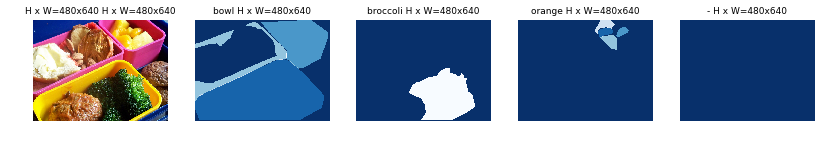

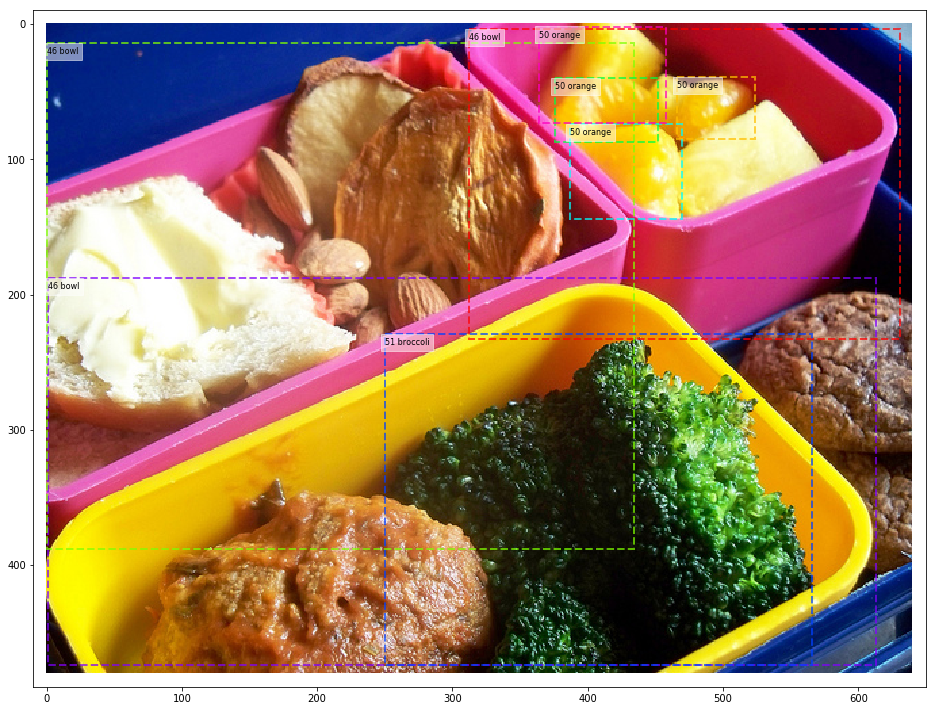

In [7]:
train_batch_x, _ = next(test_generator)
display_training_batch(dataset_test, train_batch_x)

# Run MRCNN detection pipeline on image

##  Run MRCNN detection pipeline on image

In [ ]:
# image, _ = get_prediction_batch(dataset_test,mrcnn_model, 2, display=True)
# image = get_image_batch(dataset_test, [0,1], display=True)

In [389]:
# from mrcnn.prep_notebook import run_mrcnn_inference_pipeline
# results = mrcnn_model.detect(image, verbose = 1)
# results = fcn_model.detect_from_images(mrcnn_model, image, verbose = 1)
# results = run_mrcnn_detection(mrcnn_model,dataset_test, image_ids=2, verbose = 1)
results1 = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_ids = [2], verbose = 1)
# results = run_mrcnn_inference_pipeline(mrcnn_model,dataset_test, image_ids = 2, verbose  =1)

Image Id  : 2     External Id: coco.9     Image Reference: http://cocodataset.org/#explore?id=9
call mrcnn.detect()
Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000
image_metas              shape: (1, 89)               min:    0.00000  max: 1024.00000
===>  call mrcnn_model.keras_model.predict()
    Wrapper for Detection Layer : call()  <class 'list'> 4
      rpn_proposals_roi  : (1, 1000, 4) <class 'numpy.ndarray'>
      mrcnn_class.shape  : (1, 1000, 81) <class 'numpy.ndarray'>
      mrcnn_bboxes.shape : (1, 1000, 81, 4) <class 'numpy.ndarray'>
      image_meta         : (1, 89) <class 'numpy.ndarray'>


 config.DETECTION_MAX_INSTANCES:  200
 Detections shape: (22, 6)

   boxes_to_image_domain(): image_meta:  <class 'numpy.ndarray'> (89,)
 pr_scores_by_class shape: (81, 200, 23)
 molded_rois: (22, 4)
 final_rois: (22, 4)
 pr_scores_by_class 

In [391]:
print(len(results1))
for i, r in enumerate(results1):
    print('\n output ', i, '  ',sorted(r.keys()))
    for key in sorted(r):
#     for item in results[0][grp]:
        print(key.ljust(20), r[key].shape)

1

 output  0    ['class_ids', 'detections', 'fcn_hm', 'fcn_hm_scores', 'fcn_scores', 'fcn_scores_by_class', 'fcn_sm', 'gt_bbox', 'gt_class_id', 'image', 'image_meta', 'molded_image', 'molded_rois', 'orig_image_meta', 'pr_hm', 'pr_hm_scores', 'pr_scores', 'pr_scores_by_class', 'rois', 'scores']
class_ids            (22,)
detections           (200, 6)
fcn_hm               (256, 256, 81)
fcn_hm_scores        (81, 200, 23)
fcn_scores           (22, 23)
fcn_scores_by_class  (81, 200, 23)
fcn_sm               (256, 256, 81)
gt_bbox              (8, 4)
gt_class_id          (8,)
image                (480, 640, 3)
image_meta           (89,)
molded_image         (1024, 1024, 3)
molded_rois          (22, 4)
orig_image_meta      (89,)
pr_hm                (256, 256, 81)
pr_hm_scores         (81, 200, 23)
pr_scores            (22, 23)
pr_scores_by_class   (81, 200, 23)
rois                 (22, 4)
scores               (22,)


In [ ]:
float_formatter = lambda x: "%10.4f" % x
int_formatter = lambda x: "%10d" % x
np_format = {}
np_format['float']=float_formatter
np_format['int']=int_formatter
np.set_printoptions(linewidth=195, precision=3, floatmode='fixed', threshold =10000, formatter = np_format)

In [404]:
r = results1[0]
# print(r['orig_image_meta'])
# for i in range(r['pr_scores'].shape[0]):
#     print(r['pr_scores'][i,:6])
#     print(r['rois'][i])
#     print(r['detections'][i])
#     print(r['molded_rois'][i])
#     print()
#     print(results[0]['pr_scores'][i,4],results[0]['pr_scores'][i,10:11],results[0]['pr_scores'][i,11:])

#### detections as returned from the model's `detect()` functon

In [411]:
lmt =10
r = results1[0]
print('       classes :', r['class_ids'][:lmt])
names  = " ".join([ '{:>10s}'.format(class_names[i]) for i in r['class_ids'][:lmt]])

print('               : ', names)
print('   orig scores :',r['scores'][:lmt])
print('   norm scores :', r['pr_scores'][:lmt,7])
# print('  pr_scores[5] :', r['pr_scores'][:,5])

print('-'*190)
print('    pr_scrs[8] :', r['pr_scores'][:lmt,8])
print(' fcn_scores[8] :', r['fcn_scores'][:lmt,8])
print()
print(' pr_scores[13] :', r['pr_scores'][:lmt,13])
print('fcn_scores[13] :', r['fcn_scores'][:lmt,13])
print()
print(' pr_scores[19] :', r['pr_scores'][:lmt,19])
print('fcn_scores[19] :', r['fcn_scores'][:lmt,19])

       classes : [        50         46         51         50         50         50         50         46         49         49]
               :      orange       bowl   broccoli     orange     orange     orange     orange       bowl   sandwich   sandwich
   orig scores : [    0.9939     0.9817     0.9583     0.9579     0.9305     0.8763     0.8659     0.8497     0.7182     0.6636]
   norm scores : [    1.0000     1.0000     1.0000     0.9638     0.9362     0.8817     0.8713     0.8655     1.0000     0.9240]
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
    pr_scrs[8] : [    0.9999     1.0000     1.0000     0.9965     0.9999     0.9963     1.0000     1.0000     1.0000     1.0000]
 fcn_scores[8] : [    0.3123    13.6164     1.6403     0.1117     0.3584     0.1601     1.2829    56.8207     0.3796     0.8284]

 pr_scores[13] : [    0.6925     0.

In [ ]:
r = results1[0]
print(r['detections'].shape)
print('   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))')
print('  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  ')
sort_by_class_order = np.argsort(r['class_ids'])


# for i in range(len( r['class_ids'])):
for i in sort_by_class_order:
#     print(i , r['rois'][i].astype(np.float), r['scores'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
#     print(i , r['detections'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
    
    print(i , r['pr_scores'][i,:8], r['pr_scores'][i,4], class_names[ r['pr_scores'][i,4].astype(np.int)])       
    print(i , 'pr: old_scores [ 8,9,10]:  '.rjust(90), r['pr_scores'][i,8:11])    
    print(i , '  alt_scores 1 [11 - 16]:  '.rjust(90), r['pr_scores'][i,11:17])    
    print(i , '  alt_scores 2 [17 - 22]:  '.rjust(90),  r['pr_scores'][i,17:23])    
    print(i)
#     print(i , r['fcn_scores'][i,:8], r['fcn_scores'][i,4], class_names[ r['fcn_scores'][i,4].astype(np.int)])    
    print(i , 'fcn: old_scores [ 8,9,10]:  '.rjust(90), r['fcn_scores'][i,8:11])    
    print(i ,  '  alt_scores 1 [11 - 16]:  '.rjust(90),r['fcn_scores'][i,11:17])    
    print(i ,  '  alt_scores 2 [17 - 22]:  '.rjust(90), r['fcn_scores'][i,17:23])    
    print()
    print(i , '  old score:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,8],r['fcn_scores'][i,8]))
    print(i , 'alt score 1:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,13],r['fcn_scores'][i,13]))
    print(i , 'alt score 2:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,19],r['fcn_scores'][i,19]))
    print()

#### Display detections

class ids:  [46, 47, 48, 49, 50, 51, 55, 56, 61]
Image Meta:  [         2        480        640          3        128          0        896       1024          1          1]


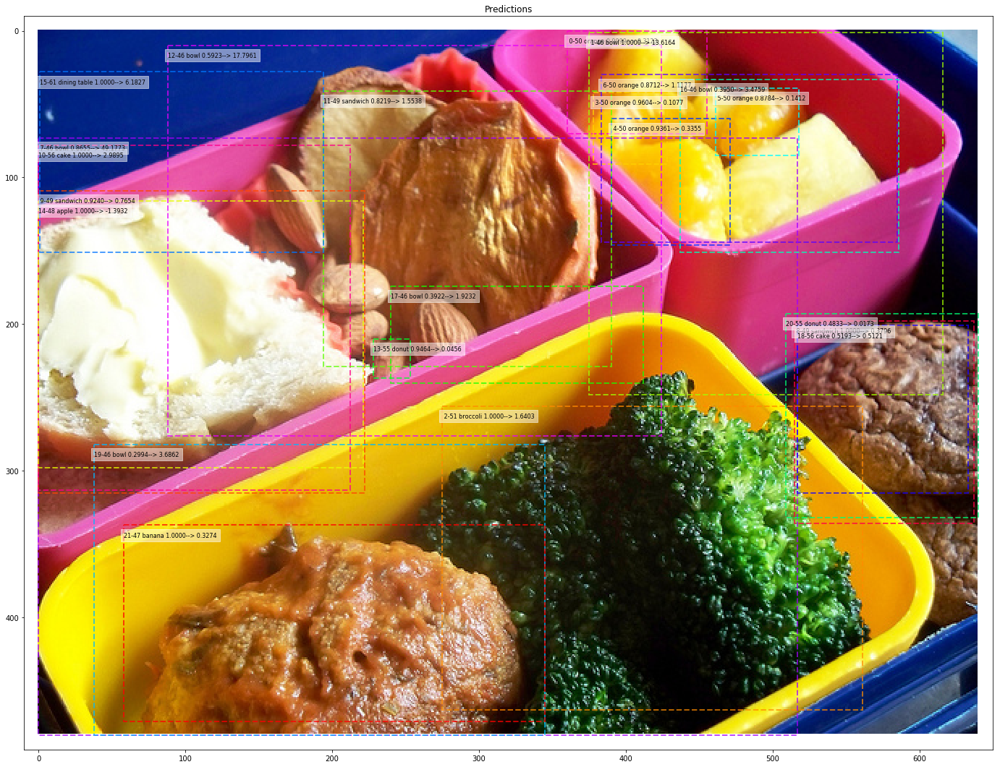

In [412]:
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
r = results1[0]

class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', r['orig_image_meta'][:10])

# visualize.display_instances(r['image'], r['rois'],  r['class_ids'], dataset_test.class_names, r['scores'], title="Predictions", score_range=(0.7, 0.99), size = 24)
# visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.0, 0.99), only_classes= [42], size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'],  r['class_ids'], class_names, r['pr_scores'][:,10], r['fcn_scores'][:,10],title="Predictions", size = 24)

### Manipulate detections 

####  before

In [414]:
import copy
r = results1[0]
del orig_detections, mod_detections
orig_detections = r['detections']
mod_detections = copy.copy(r['detections'])
for i in range(len( r['class_ids'])):
    print(i , ' original :' , orig_detections[i], class_names[orig_detections[i,4].astype(np.int)]) ## , '      orig class_id ', results[0]['class_ids'][i], class_names[results[0]['class_ids'][i]])
    print(i , ' modified :' ,  mod_detections[i], class_names[ mod_detections[i,4].astype(np.int)]) 
    print()

0  original : [  128.0000   576.0000   241.0000   729.0000    50.0000     0.9939] orange
0  modified : [  128.0000   576.0000   241.0000   729.0000    50.0000     0.9939] orange

1  original : [  131.0000   601.0000   526.0000   986.0000    46.0000     0.9817] bowl
1  modified : [  131.0000   601.0000   526.0000   986.0000    46.0000     0.9817] bowl

2  original : [  538.0000   441.0000   870.0000   899.0000    51.0000     0.9583] broccoli
2  modified : [  538.0000   441.0000   870.0000   899.0000    51.0000     0.9583] broccoli

3  original : [  196.0000   606.0000   275.0000   685.0000    50.0000     0.9579] orange
3  modified : [  196.0000   606.0000   275.0000   685.0000    50.0000     0.9579] orange

4  original : [  225.0000   625.0000   362.0000   755.0000    50.0000     0.9305] orange
4  modified : [  225.0000   625.0000   362.0000   755.0000    50.0000     0.9305] orange

5  original : [  191.0000   739.0000   265.0000   829.0000    50.0000     0.8763] orange
5  modified : [ 

#### modify and after 

In [415]:
mod_detections[4,4] = 33 ## 50 -->  33.0
mod_detections[18,4] = 30 ## 56 -->  30.0
mod_detections[20,4] = 36 ## 55 --> 36.0
print(mod_detections.shape)
for i in range(len( results[0]['class_ids'])):
    print(i , ' original :' , orig_detections[i], class_names[orig_detections[i,4].astype(np.int)]) ## , '      orig class_id ', results[0]['class_ids'][i], class_names[results[0]['class_ids'][i]])
    print(i , ' modified :' ,  mod_detections[i], class_names[ mod_detections[i,4].astype(np.int)], '      orig class_id ', results[0]['class_ids'][i], class_names[results[0]['class_ids'][i]])
    print()

(200, 6)
0  original : [  128.0000   576.0000   241.0000   729.0000    50.0000     0.9939] orange
0  modified : [  128.0000   576.0000   241.0000   729.0000    50.0000     0.9939] orange       orig class_id  42 cup

1  original : [  131.0000   601.0000   526.0000   986.0000    46.0000     0.9817] bowl
1  modified : [  131.0000   601.0000   526.0000   986.0000    46.0000     0.9817] bowl       orig class_id  55 donut

2  original : [  538.0000   441.0000   870.0000   899.0000    51.0000     0.9583] broccoli
2  modified : [  538.0000   441.0000   870.0000   899.0000    51.0000     0.9583] broccoli       orig class_id  61 dining table

3  original : [  196.0000   606.0000   275.0000   685.0000    50.0000     0.9579] orange
3  modified : [  196.0000   606.0000   275.0000   685.0000    50.0000     0.9579] orange       orig class_id  74 book

4  original : [  225.0000   625.0000   362.0000   755.0000    50.0000     0.9305] orange
4  modified : [  225.0000   625.0000   362.0000   755.0000    

###  Get contextual heatmap layer outputs for modified detections

In [416]:
layer_dictionary = {v.name: i for i, v in enumerate(mrcnn_model.keras_model.layers)}
# pp.pprint(layer_dictionary)
print(layer_dictionary['cntxt_layer'])
print(mrcnn_model.keras_model.layers[377].input)
print(mrcnn_model.keras_model.layers[377].output)
import keras.backend as KB
adjust_heatmap = KB.function([mrcnn_model.keras_model.layers[377].input],mrcnn_model.keras_model.layers[377].output )

# t_detect = KB.identity(np.expand_dims(results[0]['detections'], axis = 0))
t_detect = np.expand_dims(mod_detections, axis = 0)
sess = KB.get_session()

mod_pr_hm, mod_pr_hm_scores = adjust_heatmap([t_detect])

print(mod_pr_hm.shape, mod_pr_hm_scores.shape)

377
Tensor("mrcnn_detection/PyFunc:0", dtype=float32)
[<tf.Tensor 'cntxt_layer/pred_heatmap:0' shape=(1, 256, 256, 81) dtype=float32>, <tf.Tensor 'cntxt_layer/pred_heatmap_scores:0' shape=(1, 81, 200, 23) dtype=float32>]
(1, 256, 256, 81) (1, 81, 200, 23)


#### See that heatmap scores have been successfully manipulated

In [82]:
# print(mod_pr_hm_scores.shape)
# print(r['pr_hm_scores'][56,:3,:10])
# print(r['pr_hm_scores'][30,:3,:10])
# print(mod_pr_hm_scores[0,56,:3, :10])
# print(mod_pr_hm_scores[0,30,:3, :10])
# print()
# print(r['pr_hm_scores'][55,:3,:10])
# print(r['pr_hm_scores'][36,:3,:10])
# print(mod_pr_hm_scores[0,55,:3, :10])
# print(mod_pr_hm_scores[0,36,:3, :10])

 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display classes: [30, 33, 36, 50, 55, 56]
 rows   2  columns : 4 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


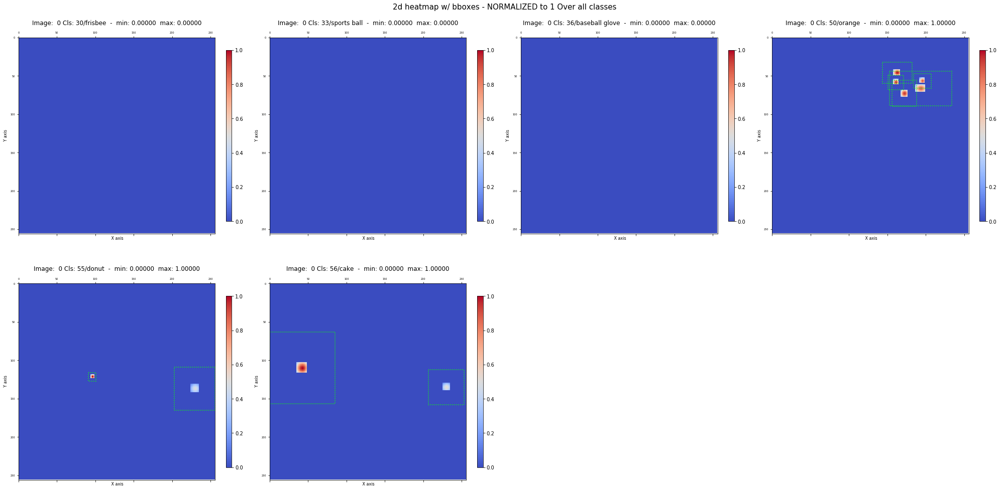

In [417]:
fig = visualize.plot_2d_heatmap(r['pr_hm'], r['pr_hm_scores'], 0,class_ids = [30,33,36,50,55,56],
                                class_names = class_names, columns = 4, scale = 4, scaling = 'all')

 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display classes: [30, 33, 36, 50, 55, 56]
 rows   2  columns : 4 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


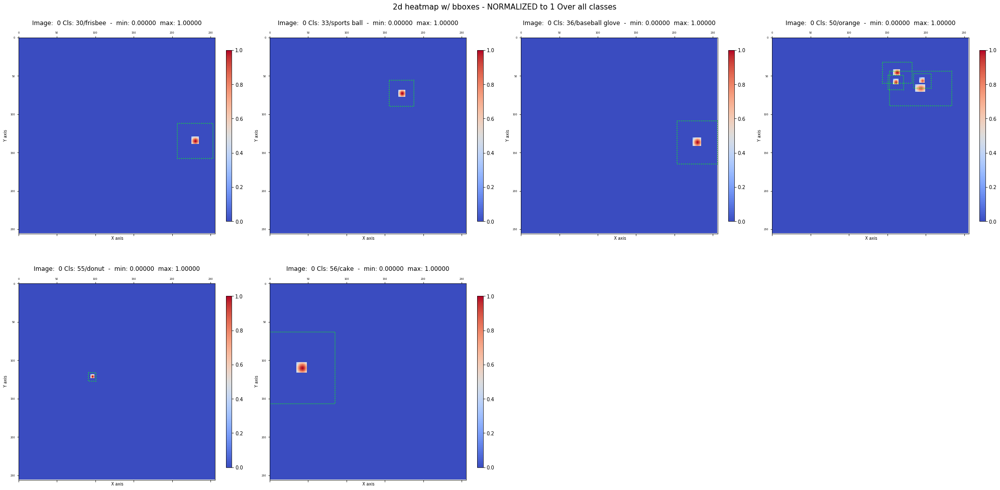

In [418]:
fig = visualize.plot_2d_heatmap(mod_pr_hm, mod_pr_hm_scores, 0,class_ids = [30,33,36,50,55,56],
                                class_names = class_names, columns = 4, scale = 4, scaling = 'all')

Image Meta:  [         2        480        640          3        128          0        896       1024          1          1]


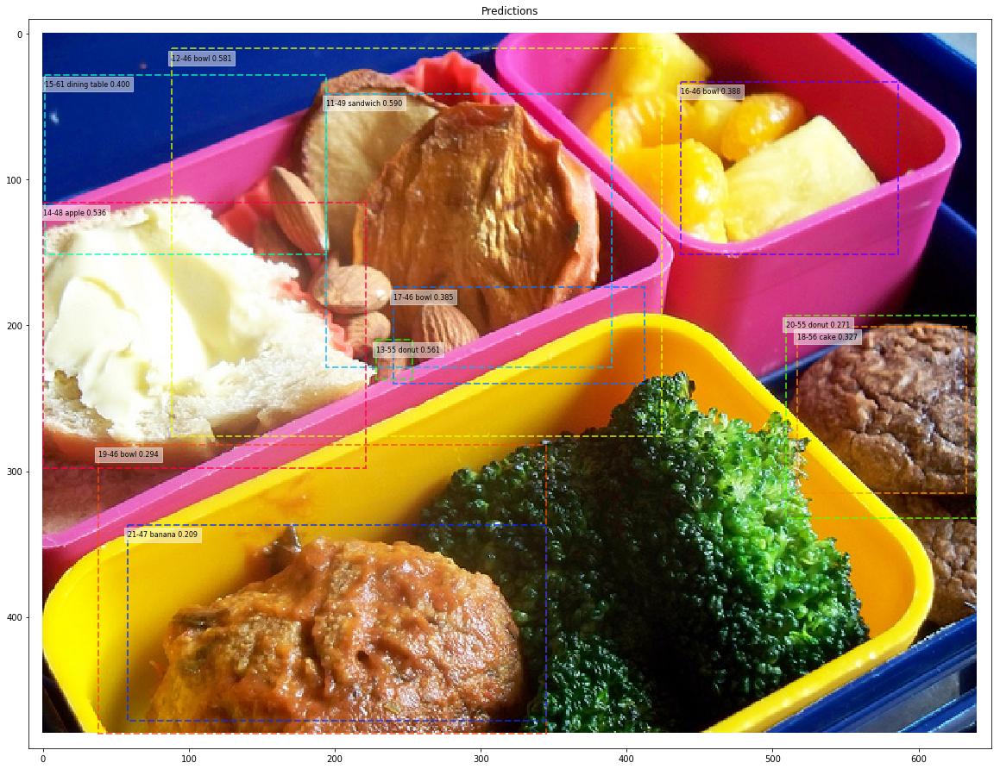

In [419]:
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
r = results1[0]
print('Image Meta: ', r['orig_image_meta'][:10])
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], dataset_test.class_names, r['scores'], 
                             title="Predictions", score_range=(0.2, 0.6), size = 20)

### Pass modified detections to fcn_model.detect() 

In [420]:
# print(r['orig_image_meta'])
mod_image_meta =  np.stack([r['image_meta'] for r in results1] )
print(mod_pr_hm_scores.shape)
print(mod_image_meta.shape)
mod_fcn_results = fcn_model.detect([mod_pr_hm, mod_pr_hm_scores, mod_image_meta])

(1, 81, 200, 23)
(1, 89)
call fcn predict()
 pr_hm          (1, 256, 256, 81)
 pr_hm_scores   (1, 81, 200, 23)
 image_metas    <class 'numpy.ndarray'> (1, 89)
1/1 [==============================] - 5s 5s/step
    return from  FCN predict()
    Length of fcn_heatmaps :  1 (1, 256, 256, 81)
    Length of fcn_softmax  :  1 (1, 256, 256, 81)
    Length of fcn_hm_scores:  1 (1, 81, 200, 23)
 Process input/results  0
 pr_hm          (256, 256, 81)
 pr_hm_scores   (81, 200, 23)
 fcn_hm         (256, 256, 81)
 fcn_hm_scores  (81, 200, 23)
   boxes_to_image_domain(): image_meta:  <class 'numpy.ndarray'> (89,)
 fcn_scores_by_class shape (81, 200, 23)


In [421]:
# print(len(mod_fcn_results))
# for i, r in enumerate(mod_fcn_results):
#     print('\n output ', i, '  ',sorted(r.keys()))
#     for key in sorted(r):
# #     for item in results[0][grp]:
#         print(key.ljust(20), r[key].shape)

1

 output  0    ['fcn_hm', 'fcn_hm_scores', 'fcn_scores', 'fcn_scores_by_class', 'fcn_sm']
fcn_hm               (256, 256, 81)
fcn_hm_scores        (81, 200, 23)
fcn_scores           (22, 23)
fcn_scores_by_class  (81, 200, 23)
fcn_sm               (256, 256, 81)


### Post modified detections from fcn_model.detect() 

#### display post modification FCN scores

In [423]:
r = results1[0]
f = mod_fcn_results[0]
print(r['detections'].shape)
print('   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))')
print('  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  ')
sort_by_class_order = np.argsort(r['class_ids'])


# for i in range(len( r['class_ids'])):
for i in sort_by_class_order:
#     print(i , r['rois'][i].astype(np.float), r['scores'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
#     print(i , r['detections'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
    
    print(i , r['pr_scores'][i,:8], r['pr_scores'][i,4], class_names[ r['pr_scores'][i,4].astype(np.int)],  f['fcn_scores'][i,4], class_names[ f['fcn_scores'][i,4].astype(np.int)])       
    print(i , 'pr: old_scores [ 8,9,10]:  '.rjust(90), r['pr_scores'][i,8:11])    
    print(i , '  alt_scores 1 [11 - 16]:  '.rjust(90), r['pr_scores'][i,11:17])    
    print(i , '  alt_scores 2 [17 - 22]:  '.rjust(90),  r['pr_scores'][i,17:23])    
    print(i)
#     print(i , r['fcn_scores'][i,:8], r['fcn_scores'][i,4], class_names[ r['fcn_scores'][i,4].astype(np.int)])    
    print(i , 'fcn: old_scores [ 8,9,10]:  '.rjust(90), f['fcn_scores'][i,8:11])    
    print(i ,  '  alt_scores 1 [11 - 16]:  '.rjust(90), f['fcn_scores'][i,11:17])    
    print(i ,  '  alt_scores 2 [17 - 22]:  '.rjust(90), f['fcn_scores'][i,17:23])    
    print()
    print(i , '  old score:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,8] ,f['fcn_scores'][i,8]))
    print(i , 'alt score 1:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,13],f['fcn_scores'][i,13]))
    print(i , 'alt score 2:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,19],f['fcn_scores'][i,19]))
    print()

(200, 6)
   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))
  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  
1 [    1.0000   375.0000   248.0000   616.0000    46.0000     0.9817   199.0000     1.0000] 46.0 bowl 46.0 bowl
1                                                                pr: old_scores [ 8,9,10]:   [    1.0000  9504.6875     1.0000]
1                                                                  alt_scores 1 [11 - 16]:   [  149.8483   210.0000     0.7136     0.6077     0.5263     1.0000]
1                                                                  alt_scores 2 [17 - 22]:   [  149.8483   210.0000     0.7136     0.6077     0.5263     1.0000]
1
1                                                               fcn: old_scores [ 8,9,10]:   [   13.5535  9504.6875    13.5535]
1                                                                  alt_scores 1 [11 - 16]:   [    2.4946   210.0000     0.0119     0.511

In [168]:
print(results[0]['detections'].shape)
for i in range(len( results[0]['class_ids'])):
#     print(i , results[0]['rois'][i], results[0]['class_ids'][i], class_names[results[0]['class_ids'][i]])
    print(i , results[0]['pr_scores'][i,:6], results[0]['pr_scores'][i,4], class_names[results[0]['pr_scores'][i,4].astype(np.int)]) 
    print(i , results[0]['pr_scores'][i,:11])    
    print(i , ' '*54, results[0]['pr_scores'][i,11:17])    
    print(i , ' '*54, results[0]['pr_scores'][i,17:23])    
    print(i , mod_fcn_results[0]['fcn_scores'][i,:6], mod_fcn_results[0]['fcn_scores'][i,4], class_names[mod_fcn_results[0]['fcn_scores'][i,4].astype(np.int)])    
    print(i ,  mod_fcn_results[0]['fcn_scores'][i,:11])    
    print(i , ' '*54, mod_fcn_results[0]['fcn_scores'][i,11:17])    
    print(i , ' '*54, mod_fcn_results[0]['fcn_scores'][i,17:23])    
    print()

(200, 6)
0 [    0.0000   360.0000    70.0000   455.0000    50.0000     0.9939] 50.0 orange
0 [    0.0000   360.0000    70.0000   455.0000    50.0000     0.9939   200.0000     1.0000     0.9999  1080.5625     0.9999]
0                                                        [   49.8582    72.0000     0.6925     0.6162     0.5538     1.0000]
0                                                        [   49.8582    72.0000     0.6925     0.6162     0.5538     1.0000]
0 [    0.0000   360.0000    70.0000   455.0000    50.0000     0.9939] 50.0 orange
0 [    0.0000   360.0000    70.0000   455.0000    50.0000     0.9939   200.0000     1.0000     0.3125  1080.5625     0.3125]
0                                                        [    0.0207    72.0000     0.0003     0.2834     0.5538     0.5116]
0                                                        [    8.4907    72.0000     0.1179     0.2834     0.5538     0.5116]

1 [    1.0000   375.0000   248.0000   616.0000    46.0000     0.9817] 46.0 b

#### display post modification FCN heatmaps

 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display all classes...
 rows   21  columns : 4 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: -0.007194447  max_z_all: () max_z_all: 0.07807254
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


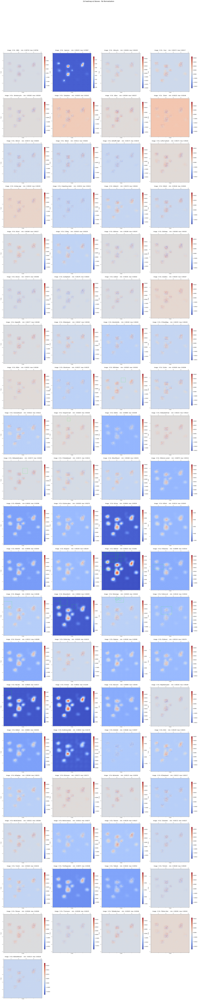

In [179]:
fig = visualize.plot_2d_heatmap(mod_fcn_results[0]['fcn_hm'], mod_fcn_results[0]['fcn_scores_by_class'], 0,
                                class_names = class_names, columns = 4, scale = 4, scaling = 'none')

#### display instances on modified fcn results

(22,) [    0.9939     0.9817     0.9583     0.9579     0.9305     0.8763     0.8659     0.8497     0.7182     0.6636     0.6295     0.5903     0.5815     0.5607     0.5359     0.4002     0.3878
     0.3851     0.3269     0.2939     0.2710     0.2085]
(22, 1) [50 46 51 50 33 50 50 46 49 49 56 49 46 55 48 61 46 46 30 46 36 47]


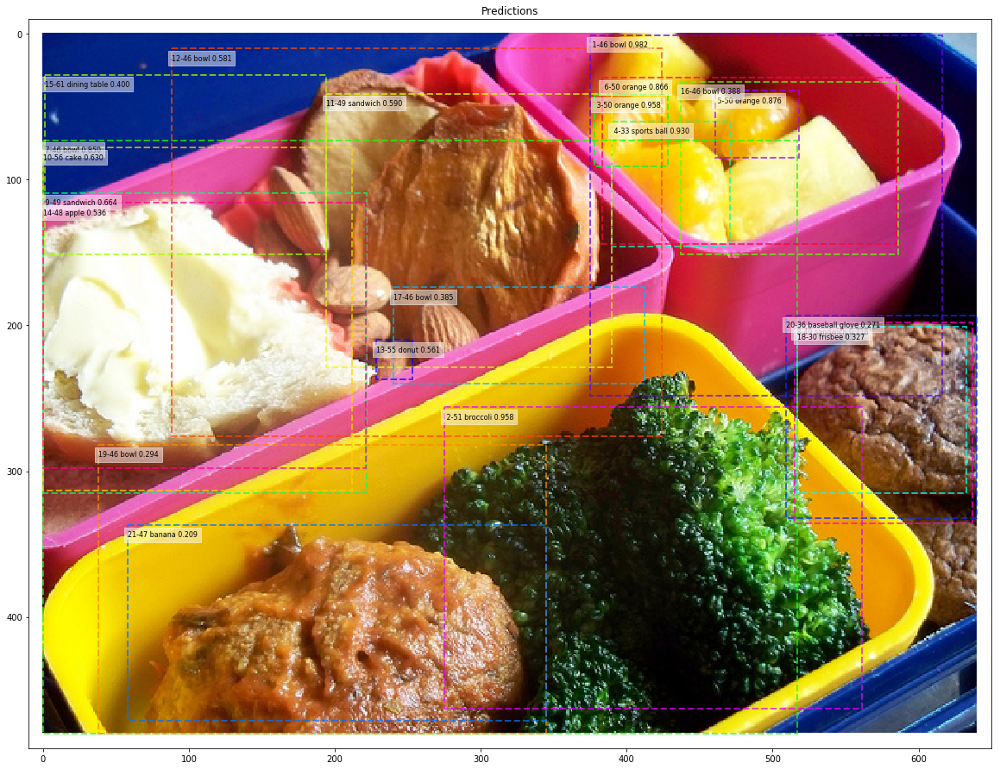

In [178]:
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
m = mod_fcn_results[0]
# print(m['fcn_scores'][:,:4].shape)
print(r['scores'].shape, r['scores'])
print(m['fcn_scores'][:,4:5].shape, m['fcn_scores'][:,4].astype(np.int))
# print('Image Meta: ', r['orig_image_meta'][:10])
visualize.display_instances(r['image'], m['fcn_scores'][:,:4],  m['fcn_scores'][:,4].astype(np.int), dataset_test.class_names, r['scores'], 
                             title="Predictions", score_range=(0.2, 0.99), size = 20)

#### Compute mAP and Display Precision/Recall Curve

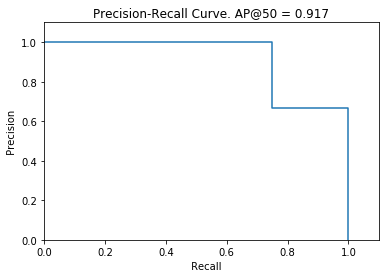

In [424]:
# Draw precision-recall curve
r = results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(r['gt_bbox'], r['gt_class_id'], 
                                          r['molded_rois'], r['class_ids'], r['scores'])
visualize.plot_precision_recall(AP, precisions, recalls)

#### print some output info from `results`

In [ ]:
r = results[0]
print('ground truth', np.expand_dims(gt_data[0]['gt_class_id'], axis =-1).shape,gt_data[0]['gt_bbox'].shape)
print(np.concatenate([gt_data[0]['gt_bbox'], np.expand_dims(gt_data[0]['gt_class_id'], axis =-1)], axis = 1))

# print('rois: / classes:')
# print(np.concatenate([r['rois'], np.expand_dims(r['class_ids'], axis = -1)], axis =-1) )
# print('molded rois:')
# print('------------')
# print(np.concatenate([r['molded_rois'], np.expand_dims(r['class_ids'], axis = -1)], axis =-1) )

print('pr_scores:')
print('----------')
print(r['pr_scores'])


#  Run MRCNN detection pipeline on second image

In [ ]:
# from mrcnn.prep_notebook import get_image_batch, get_training_batch
# # images = get_image_batch(dataset_test, 4737, display = True)
# image, _ = get_inference_batch(dataset_test,mrcnn_model, 4745, display=True)

In [213]:
# from mrcnn.prep_notebook import run_fcn_detection
# fcn_results, fcn_gt_data = run_fcn_detection(fcn_model, mrcnn_model,dataset_test, image_id=1927, verbose = 1)
# results= run_mrcnn_detection(mrcnn_model,dataset_test, image_ids=4745, verbose = 1)
results = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_ids = [4745], verbose = 1)

Image Id  : 4745     External Id: coco.276037     Image Reference: http://cocodataset.org/#explore?id=276037
call mrcnn.detect()
Processing 1 images
image                    shape: (640, 448, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000
image_metas              shape: (1, 89)               min:    0.00000  max: 1024.00000
    call mrcnn_model.keras_model.predict()
    Wrapper for Detection Layer : call()  <class 'list'> 4
      rpn_proposals_roi  : (1, 1000, 4) <class 'numpy.ndarray'>
      mrcnn_class.shape  : (1, 1000, 81) <class 'numpy.ndarray'>
      mrcnn_bboxes.shape : (1, 1000, 81, 4) <class 'numpy.ndarray'>
      image_meta         : (1, 89) <class 'numpy.ndarray'>


 config.DETECTION_MAX_INSTANCES:  200
 Detections shape: (13, 6)

   boxes_to_image_domain(): image_meta:  <class 'numpy.ndarray'> (89,)
 pr_scores_by_class shape: (81, 200, 23)
 molded_rois: (13, 4)
 final_rois: (13, 4)
 pr_score

D:\Program Files\Anaconda3\envs\TF\lib\site-packages\scipy\ndimage\interpolation.py:583: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


# Analyze results

#### detections as returned from the model's `detect()` functon

In [368]:
# print(results[0]['detections'].shape)
# for i in range(len( results[0]['class_ids'])):
#     print(i , results[0]['rois'][i].astype(np.float), results[0]['scores'][i], results[0]['class_ids'][i], class_names[results[0]['class_ids'][i]])
#     print(i , results[0]['pr_scores'][i,:6], results[0]['pr_scores'][i,4], class_names[results[0]['pr_scores'][i,4].astype(np.int)])
#     print(i , ' '*54, results[0]['pr_scores'][i,7:11])    
#     print(i , ' '*54, results[0]['pr_scores'][i,11:16])    
#     print(i , ' '*54, results[0]['fcn_scores'][i,11:16])    
#     print()
float_formatter = lambda x: "%10.4f" % x
int_formatter = lambda x: "%10d" % x
np_format = {}
np_format['float']=float_formatter
np_format['int']=int_formatter
np.set_printoptions(linewidth=195, precision=3, floatmode='fixed', threshold =10000, formatter = np_format)

In [353]:
r = results[0]
print(r['detections'].shape)
print('   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))')
print('  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  ')
sort_by_class_order = np.argsort(r['class_ids'])


# for i in range(len( r['class_ids'])):
for i in sort_by_class_order:
#     print(i , r['rois'][i].astype(np.float), r['scores'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
#     print(i , r['detections'][i], r['class_ids'][i], class_names[r['class_ids'][i]])
    
    print(i , r['pr_scores'][i,:8], r['pr_scores'][i,4], class_names[ r['pr_scores'][i,4].astype(np.int)])       
    print(i , 'pr: old_scores [ 8,9,10]:  '.rjust(90), r['pr_scores'][i,8:11])    
    print(i , '  alt_scores 1 [11 - 16]:  '.rjust(90), r['pr_scores'][i,11:17])    
    print(i , '  alt_scores 2 [17 - 22]:  '.rjust(90),  r['pr_scores'][i,17:23])    
    print(i)
#     print(i , r['fcn_scores'][i,:8], r['fcn_scores'][i,4], class_names[ r['fcn_scores'][i,4].astype(np.int)])    
    print(i , 'fcn: old_scores [ 8,9,10]:  '.rjust(90), r['fcn_scores'][i,8:11])    
    print(i ,  '  alt_scores 1 [11 - 16]:  '.rjust(90),r['fcn_scores'][i,11:17])    
    print(i ,  '  alt_scores 2 [17 - 22]:  '.rjust(90), r['fcn_scores'][i,17:23])    
    print()
    print(i , '  old score:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,8],r['fcn_scores'][i,8]))
    print(i , 'alt score 1:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,13],r['fcn_scores'][i,13]))
    print(i , 'alt score 2:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(r['pr_scores'][i,19],r['fcn_scores'][i,19]))
    print()
    

(200, 6)
   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))
  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  
9 [   18.0000   170.0000   228.0000   322.0000    40.0000     0.5009   191.0000     1.0000] 40.0 bottle
9                                                                pr: old_scores [ 8,9,10]:   [    1.0000  5103.0000     1.0000]
9                                                                  alt_scores 1 [11 - 16]:   [  111.2440   156.0000     0.7131     1.0000     1.0000     1.0000]
9                                                                  alt_scores 2 [17 - 22]:   [  111.2440   156.0000     0.7131     1.0000     1.0000     1.0000]
9
9                                                               fcn: old_scores [ 8,9,10]:   [    5.7329  5103.0000     5.7329]
9                                                                  alt_scores 1 [11 - 16]:   [    0.2517   156.0000     0.0016     1.0000     1.

In [388]:
print('       classes :', r['class_ids'])
# strFormat = len(r['class_ids']) * '{:10s} '
# names     = strFormat.format([class_names[i] for i in r['class_ids']])
# names  = " ".join([ '{:11s}'.format(class_names[i].rstrip(10)) for i in r['class_ids']])
print('               : ', names)
print('   orig scores :',r['scores'])
print('   norm scores :', r['pr_scores'][:,7])
# print('  pr_scores[5] :', r['pr_scores'][:,5])

print('-'*190)
print('  pr_scores[8] :', r['pr_scores'][:,8])
print(' fcn_scores[8] :', r['fcn_scores'][:,8])
print()
print(' pr_scores[13] :', r['pr_scores'][:,13])
print('fcn_scores[13] :', r['fcn_scores'][:,13])
print()
print(' pr_scores[19] :', r['pr_scores'][:,19])
print('fcn_scores[19] :', r['fcn_scores'][:,19])

       classes : [        42         55         61         74         74         42         61         72         45         40         46         56         42]
               :  cup         donut       dining table book        book        cup         dining table sink        spoon       bottle      bowl        cake        cup        
   orig scores : [    0.9868     0.9839     0.9187     0.9010     0.8916     0.8605     0.7885     0.5879     0.5422     0.5009     0.4983     0.3342     0.3234]
   norm scores : [    1.0000     1.0000     1.0000     1.0000     0.9896     0.8720     0.8583     1.0000     1.0000     1.0000     1.0000     1.0000     0.3277]
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  pr_scores[8] : [    1.0000     1.0000     1.0000     0.9999     1.0000     1.0000     1.0000     0.9998     0.9967     1.0000     1.0000     0.99

### Display detections

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
Image Meta:  [4745  640  448    3    0  153 1024  870    1    1]


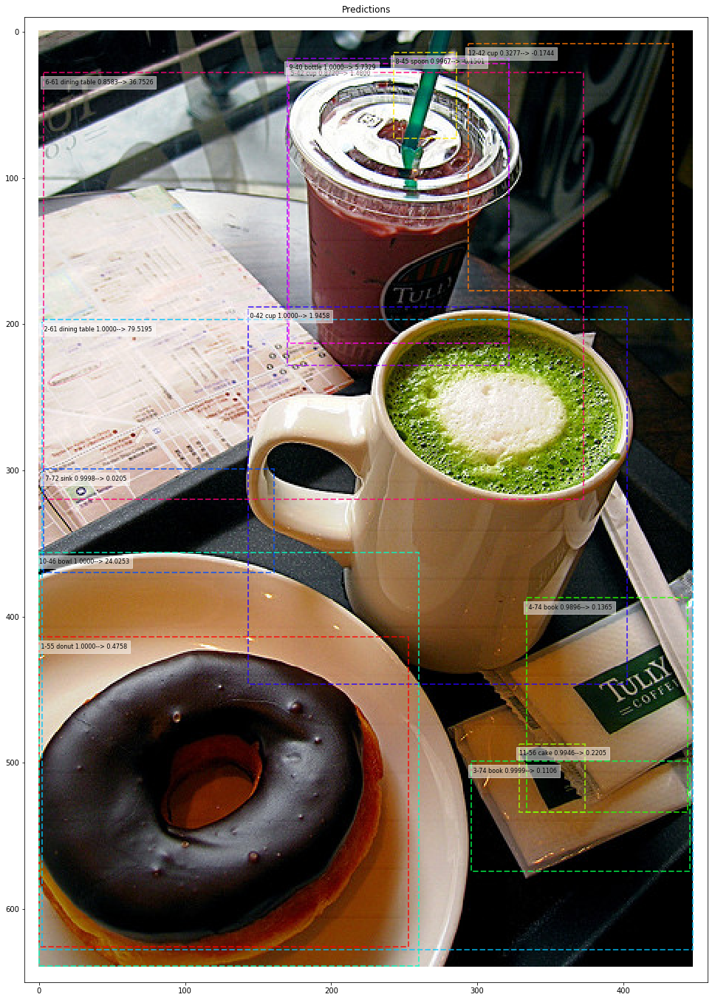

In [366]:
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
r = results[0]
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', r['orig_image_meta'][:10])
# visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.0, 0.99), only_classes= [42], size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'],  r['class_ids'], class_names, r['pr_scores'][:,10], r['fcn_scores'][:,10],title="Predictions", size = 24)
# visualize.display_instances(r['image'], r['pr_scores'][:,:4],  r['pr_scores'][:,4].astype(np.int), class_names, r['scores'], title="Predictions", score_range=(0.2, 0.7), size = 14)

### Pr_heatmap Plots

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
(256, 256)


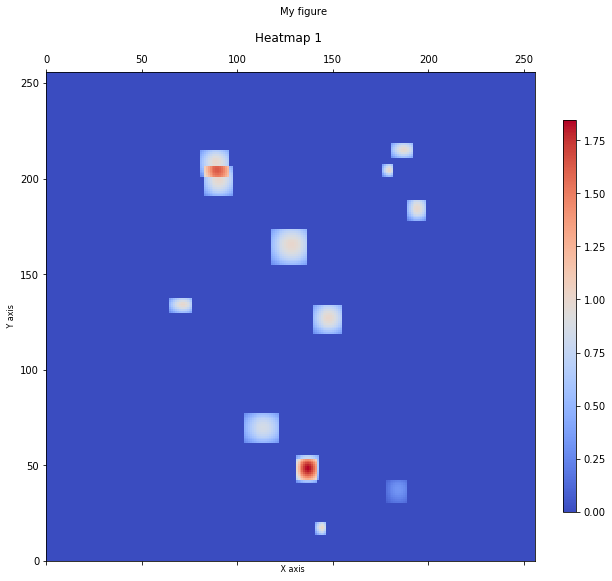

 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display classes: [40, 42, 45, 46, 55, 56, 61, 72, 74]
 rows   3  columns : 4 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


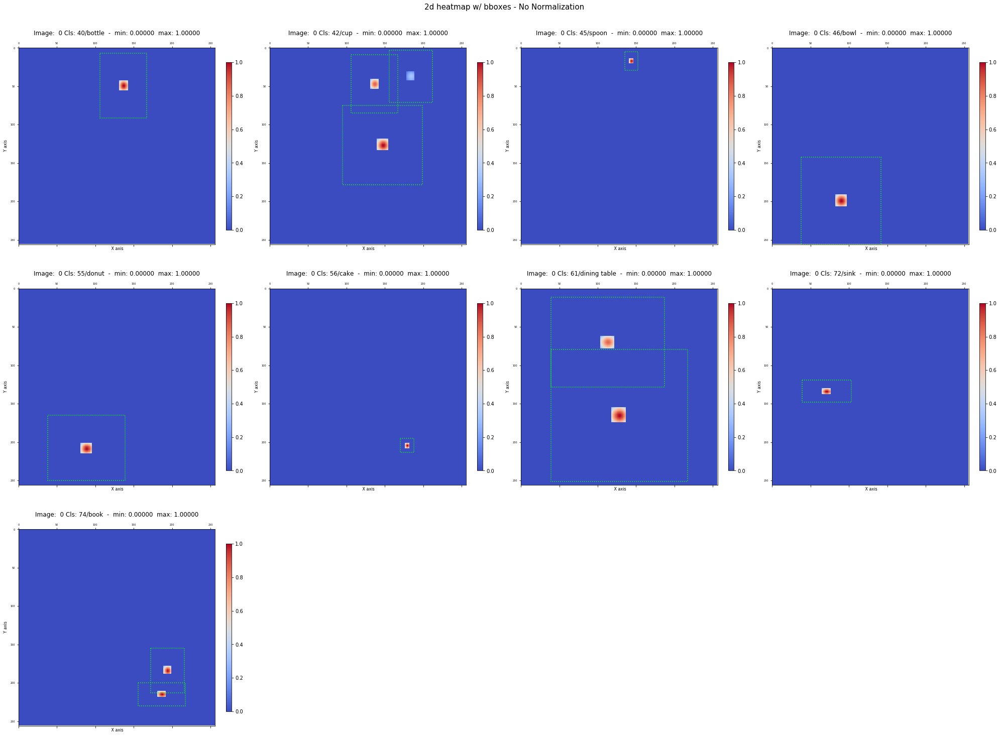

In [241]:
# print(model_gt_heatmap_scores.shape)
r = results[0]
# print(r['pr_hm_scores'].shape, r['pr_scores'].shape, r['pr_scores_by_class'].shape)
# print(np.unique(r['pr_hm_scores'][:,:,4]).astype(int).tolist())
# print(np.unique(r['pr_scores_by_class'][:,:,4]).astype(int).tolist())
# print(np.unique(r['pr_scores'][:,4]).astype(int).tolist())
# print(r['pr_hm'].shape)
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
pr_sum = 

visualize.plot_2d_gaussian(np.sum(r['pr_hm'], axis=-1)
fig = visualize.plot_2d_heatmap(r['pr_hm'], r['pr_hm_scores'], 0, class_ids = class_ids,
                                class_names = class_names, columns = 4, scale = 4, scaling = 'none')

### FCN Heatmap Plots

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display classes: [40, 42, 45, 46, 55, 56, 61, 72, 74]
 rows   3  columns : 4 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: -0.01673643  max_z_all: () max_z_all: 0.1650681
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


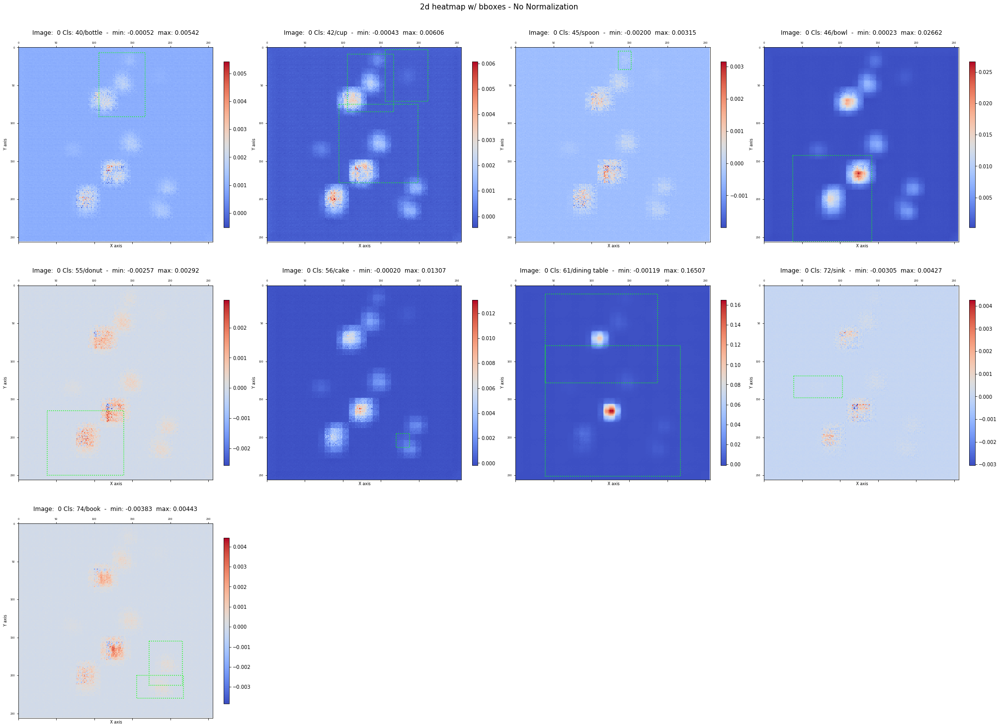

In [243]:
# print(model_gt_heatmap_scores.shape)
r = results[0]
# print(r['pr_hm_scores'].shape, r['pr_scores'].shape, r['pr_scores_by_class'].shape)
# print(np.unique(r['pr_hm_scores'][:,:,4]).astype(int).tolist())
# print(np.unique(r['pr_scores_by_class'][:,:,4]).astype(int).tolist())
# print(np.unique(r['pr_scores'][:,4]).astype(int).tolist())
class_ids = np.unique(r['fcn_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)

fig = visualize.plot_2d_heatmap(r['fcn_hm'], r['fcn_hm_scores'], 0, class_ids = class_ids,
                                class_names = class_names, columns = 4, scale = 4, scaling = 'none')

### Compare MRCNN and FCN Heatmap Plots side by side

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
Display classes: [0, 1, 2, 3, 4]
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.01673643  max_z2_all: () max_z2_all: 0.1650681


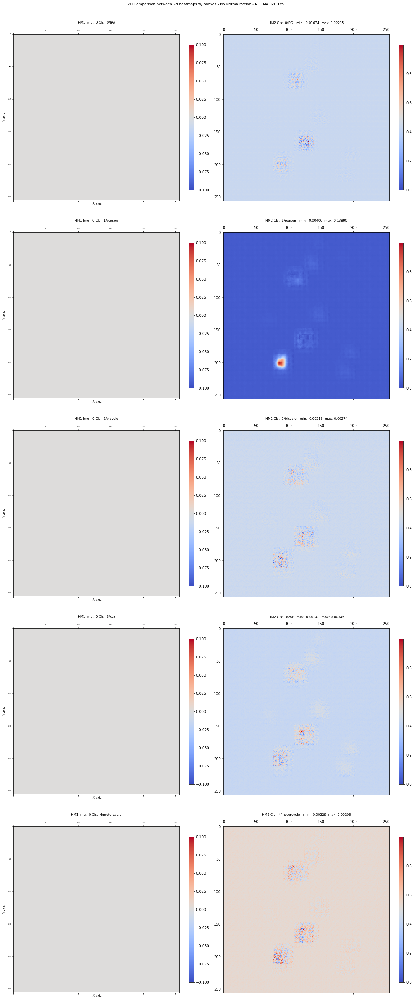

In [266]:
class_ids = np.unique(r['fcn_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
fig = visualize.plot_2d_heatmap_compare( r['pr_hm'], r['fcn_hm'], r['fcn_hm_scores'], 0, class_ids = [0,1,2,3,4],   
                              num_bboxes = 0, class_names=class_names, scale = 4, scaling = 'none')

### Overlay image with pr_heatmaps

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 23)
Display classes: [40, 42, 45, 46, 55, 56, 61, 72, 74]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


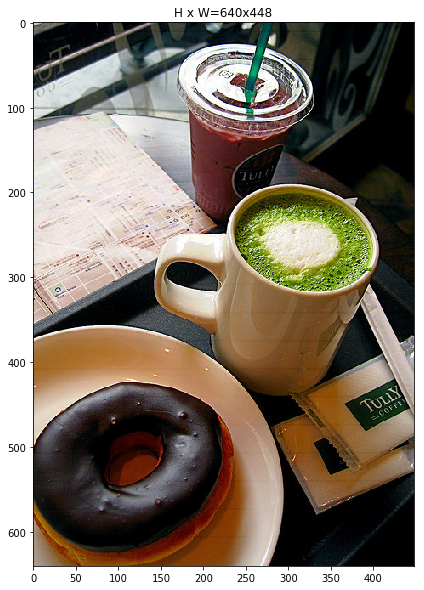

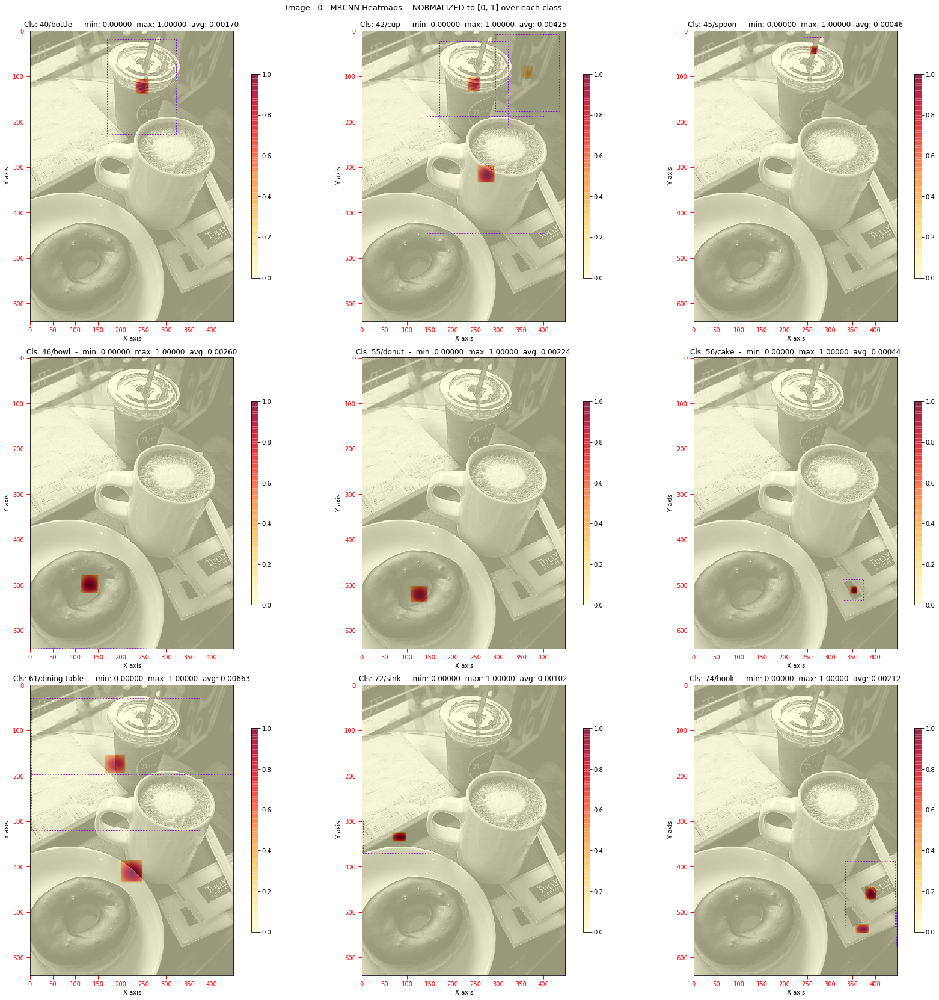

In [271]:
from mrcnn.visualize import inference_heatmaps_display  ## display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, 
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(results, 0, class_ids = class_ids, class_names = class_names, hm = 'pr_hm' ,config = mrcnn_model.config, scaling = 'class') 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

### Overlay image with fcn_heatmaps

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 23)
Display classes: [40, 42, 45, 46, 55, 56, 61, 72, 74]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


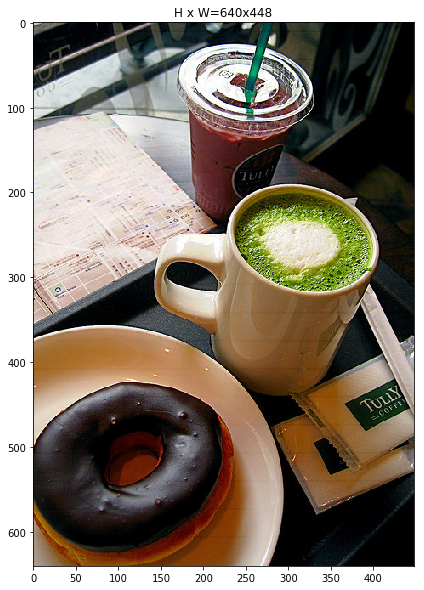

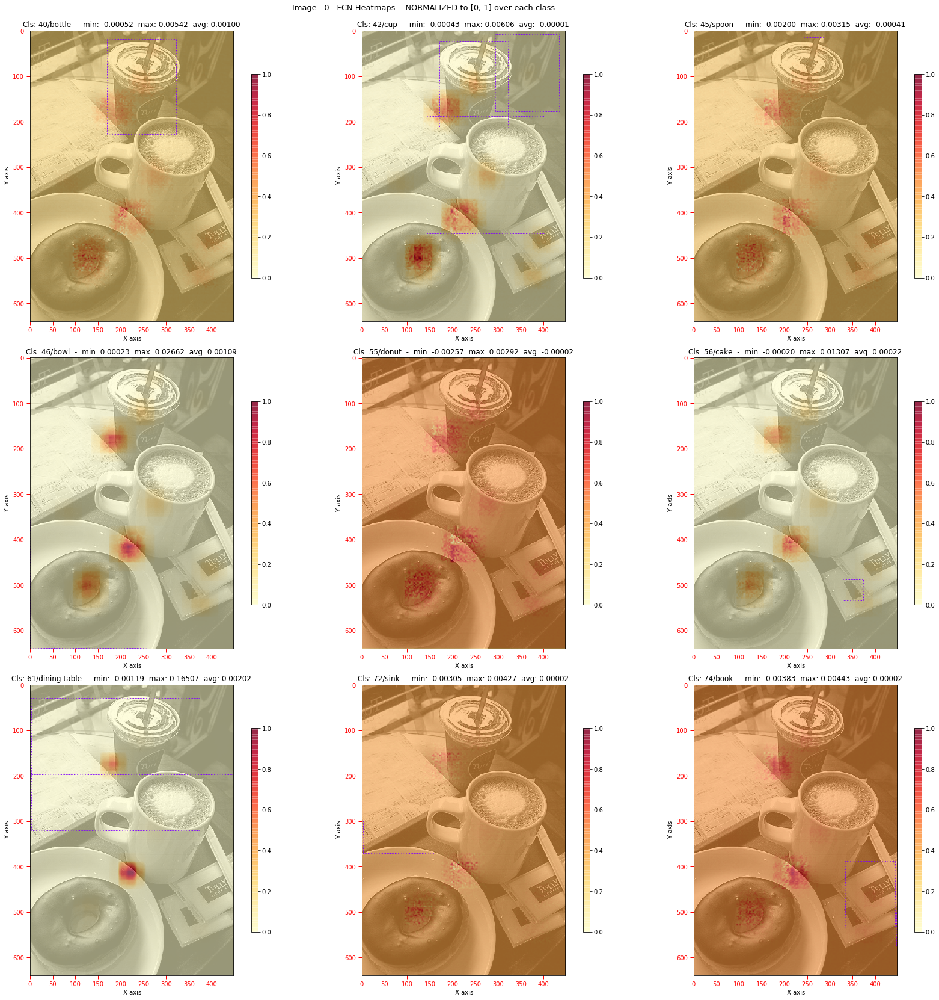

In [270]:
from mrcnn.visualize import inference_heatmaps_display  ## display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, 
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(results, 0, class_ids = class_ids, class_names = class_names, hm = 'fcn_hm' ,config = mrcnn_model.config, scaling = 'class') 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

### Comapre Overlay image with fcn_heatmaps / pr_heatmaps

class ids:  [40, 42, 45, 46, 55, 56, 61, 72, 74]
 Scaling options are: 'all', 'class', 'each' , or  'clip' : 
 heatmap shape:  (256, 256, 81)
 Bounding boxes shape:  (81, 200, 23)
Image shape : (640, 448, 3)  class_ids: [40 42 45 46 55 56 61 72 74]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


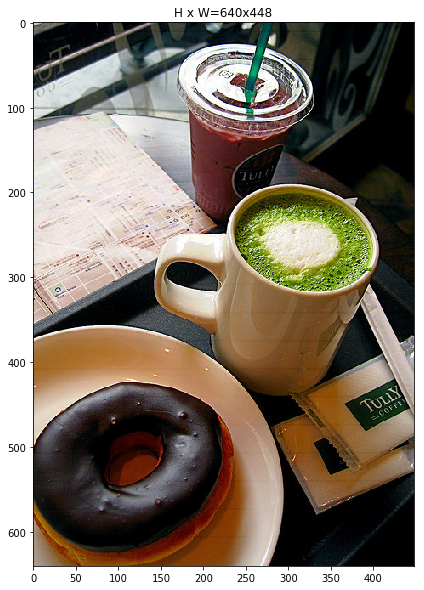

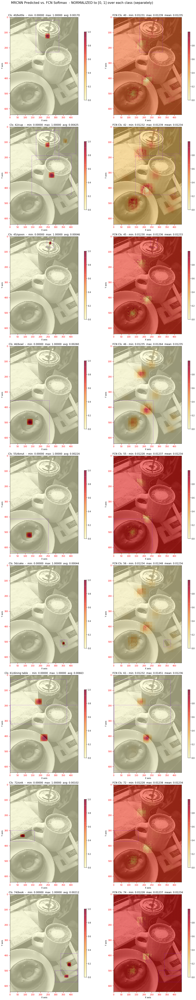

In [278]:
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
visualize.inference_heatmaps_compare(results, 0, class_ids = class_ids, class_names = class_names, hm = 'fcn_sm' ,config = mrcnn_model.config, scaling = 'each') 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

#### Compute mAP and Display Precision/Recall Curve

In [ ]:
r = results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(r['gt_bbox'], r['gt_class_id'], r['molded_rois'], r['class_ids'], r['scores'])
visualize.plot_precision_recall(AP, precisions, recalls)

#  Run MRCNN detection pipeline on third image

### Load a specific image using `get_inference_batch()`

In [ ]:
# 13378, 33816
image, _ = get_inference_batch(dataset_test, mrcnn_model, 13378, display=True)    

In [ ]:
results= run_mrcnn_detection(mrcnn_model,dataset_test, image_id=13378, verbose = 0)
r = results[0]

In [ ]:
print('Image Meta: ', r['orig_image_meta'][:10])
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], dataset_test.class_names, r['scores'], 
                             title="Predictions", score_range=(0.0, 0.7))


# FCN Detection

In [ ]:
image_list = list(range(0,40))
image_titles = [str(i) for i in image_list]
images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

In [ ]:
image, _ = get_inference_batch(dataset_test,mrcnn_model, 33, display=True)
# image = get_image_batch(dataset_test, 10, display=True)

In [ ]:
fcn_results = run_fcn_detection(fcn_model, mrcnn_model, dataset_test, image_id = 10, verbose = 1)

### Display FCN detections

In [ ]:
f = fcn_results[0]
print('Image Meta: ', f['orig_image_meta'][:10])
visualize.display_instances(f['image'], f['rois'],  f['class_ids'], dataset_test.class_names, f['mrcnn_scores'], 
                             title="Predictions", score_range=(0.0, 0.7))


In [ ]:
float_formatter = lambda x: "%10.4f" % x
np_format = {}
np_format['float']=float_formatter
np.set_printoptions(linewidth=195, precision=3, floatmode='fixed', threshold =10000, formatter = np_format)


In [ ]:
# float_formatter = lambda x: "%10.4f" % x
# np_format = {}
# np_format['float']=float_formatter
# np.set_printoptions(linewidth=195, precision=3, floatmode='fixed', threshold =10000, formatter = np_format)
# for i in range(results[0]['pr_scores'].shape[0]):
#     print(results[0]['pr_scores'][i,7:])

In [ ]:
for molded_bbox, cls, scr, pr_scr, fcn_scr in zip(f['molded_rois'].astype(np.int), f['class_ids'],  f['mrcnn_scores'], f['pr_scores'], f['fcn_scores']):
    print('{} {:2d}  {:.<18s}  {:5.4f} {}  '.format(molded_bbox, cls, dataset_test.class_names[cls], scr, fcn_scr[[4,5,6,7]]))
    print('{:>86s} {}'.format(' mrcnn old style scores:  ',pr_scr[[8,9,10]]))
    print('{:>86s} {}'.format(' fcn old style scores:  ',fcn_scr[[8,9,10]]))
    print('{:>86s} {}'.format(' mrcnn alt scores1:  ',pr_scr[[11,12,13,14,15,16]]))
    print('{:>86s} {}'.format(' mrcnn_scores2 :  ',pr_scr[[17,18,19,20,21,22]]))
    
    print('{:>86s} {}'.format(' fcn alt scores1:  ',fcn_scr[[11,12,13,14,15,16]]))
    print('{:>86s} {}'.format(' fcn_scores2:  ',fcn_scr[[17,18,19,20,21,22]]))
    print()

#  Compute AP routine

In [ ]:
from mrcnn.utils import trim_zeros, compute_overlaps
def compute_ap(gt_boxes, gt_class_ids,
               pred_boxes, pred_class_ids, pred_scores,
               iou_threshold=0.5):
    '''
    Compute Average Precision at a set IoU threshold (default 0.5).

    Returns:
    mAP:            Mean Average Precision
    precisions:     List of precisions at different class score thresholds.
    recalls:        List of recall values at different class score thresholds.
    overlaps:       [pred_boxes, gt_boxes] IoU overlaps.
    '''
    # Trim zero padding and sort predictions by score from high to low
    # TODO: cleaner to do zero unpadding upstream
    gt_boxes   = trim_zeros(gt_boxes)
    pred_boxes = trim_zeros(pred_boxes)
    pred_scores= pred_scores[:pred_boxes.shape[0]]
    indices    = np.argsort(pred_scores)[::-1]   ## sort indices from largest to smallest
    print('arg_sort indicies:', indices)
    pred_boxes     = pred_boxes[indices]
    pred_class_ids = pred_class_ids[indices]
    pred_scores    = pred_scores[indices]
    
    print(' Total predicitons: ')
    print(len(pred_class_ids), len(pred_boxes), len(pred_scores))
    # Compute IoU overlaps [pred_boxes, gt_boxes]
    overlaps = compute_overlaps(pred_boxes, gt_boxes)
    print('ovelatps: ',overlaps.shape)
    print(overlaps)
    
    # Loop through ground truth boxes and find matching predictions
    match_count = 0
    pred_match = np.zeros([pred_boxes.shape[0]])
    gt_match   = np.zeros([gt_boxes.shape[0]])
    
    for i in range(len(pred_boxes)):
        # Find best matching ground truth box
        sorted_ixs = np.argsort(overlaps[i])[::-1]
        for j in sorted_ixs:
            # If ground truth box is already matched, go to next one
            if gt_match[j] == 1:
                continue
            # If we reach IoU smaller than the threshold, end the loop
            iou = overlaps[i, j]
            if iou < iou_threshold:
                break
            # Do we have a match?
            if pred_class_ids[i] == gt_class_ids[j]:
                match_count  += 1
                gt_match[j]   = 1
                pred_match[i] = 1
                break
    print(' after overlap computation')
    print('pred_match :', pred_match)
    print('  gt_match :', gt_match)
    # Compute precision and recall at each prediction box step
    precisions = np.cumsum(pred_match) / (np.arange(len(pred_match)) + 1)
    recalls    = np.cumsum(pred_match).astype(np.float32) / len(gt_match)
    
    print(' precisions')
    print(np.cumsum(pred_match), '/', (np.arange(len(pred_match)) + 1))
    print(precisions)
    print()
    print(' recalls ')
    print(np.cumsum(pred_match), '/', len(gt_match))
    print(recalls)
    print()
    
    # Pad with start and end values to simplify the math
    precisions = np.concatenate([[0], precisions, [0]])
    recalls    = np.concatenate([[0], recalls, [1]])
    print('appended [0/0], [0/1] to front/end of precisions/recalls')
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    
    # Ensure precision values decrease but don't increase. This way, the
    # precision value at each recall threshold is the maximum it can be
    # for all following recall thresholds, as specified by the VOC paper.
    for i in range(len(precisions) - 2, -1, -1):
        precisions[i] = np.maximum(precisions[i], precisions[i + 1])
    print('backtracking precsiosn values:', list(range(len(precisions) - 2, -1, -1)))
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    # Compute mean AP over recall range
    print(' Rc[:-1] : ', recalls[:-1])
    print(' Rc[1:]  : ', recalls[1:])
    print(' Pr[1:]  : ', precisions[1:])
    print()

    ## find points where recall values changes 
    indices = np.where(recalls[:-1] != recalls[1:])[0] + 1
    mAP     = np.sum((recalls[indices] - recalls[indices - 1]) * precisions[indices])
    
    print('where recalls[:-1] != recalls[1:]:', np.where(recalls[:-1] != recalls[1:]))
    print('indices at recall changes : ', indices)
    print(' A1: recall[indices]  : ', recalls[indices])
    print(' A2: recall[indices-1]: ', recalls[indices-1])
    print(' A1 - A2              : ', (recalls[indices] - recalls[indices - 1]))
    print(' P1:precision[indices]: ', precisions[indices])
    print(' (A1-A2)*P1           : ', (recalls[indices] - recalls[indices - 1]) * precisions[indices])
    print(' Sum = mAP            : ', mAP)
    print(' Pr        : ', precisions)
    print(' Rc        : ', recalls)
    print(' Pr*Rc     : ', precisions*recalls)
    print(' Sum(Pr*Rc): ', np.sum(precisions*recalls))
    print(' Sum(Pr*Rc)/m: ', np.sum(precisions*recalls)/len(precisions))
    return mAP, precisions, recalls, overlaps

In [ ]:
AP, precisions, recalls, overlaps = compute_ap(gt_data[0]['gt_bbox'], gt_data[0]['gt_class_id'], 
                                          r['molded_rois'], r['class_ids'], r['scores'])

In [ ]:
len(precisions)
precisions


In [ ]:
f = fcn_results[0]
f.keys()

# Display Heatmaps

In [ ]:
from mrcnn.visualize import (plot_one_bbox_heatmap, 
                             plot_3d_heatmap, plot_2d_heatmap, 
                              plot_2d_heatmap_compare, plot_3d_heatmap_compare)
# import matplotlib as plt
# %matplotlib inline
img_id = 0
image_id=f['orig_image_meta'][0]
print('Image id: ',image_id, ' Coco ID: ', dataset_test.image_info[image_id]['id'])
print(f['pr_scores'][:,4])
coco_class_names = dataset_test.class_names
pr_class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
fcn_class_ids = np.unique(f['fcn_scores'][:,4]).astype(int).tolist()
print('Pred class ids: ', pr_class_ids)
print('FCN  class ids: ', fcn_class_ids)

### 2D Plotts

 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Image Id:  0  Display all classes...
 rows   27  columns : 3 boxes.shape :  (81, 200, 23)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


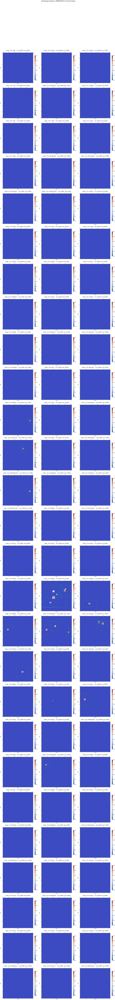

In [182]:
fig = visualize.plot_2d_heatmap(mod_pr_hm, mod_pr_hm_scores, 0,
                                class_names = class_names, columns = 3, scale = 4, scaling = 'all')

#### Overlay image with pred_heatmaps

In [ ]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'pr_hm' ,config = mrcnn_model.config, scaling = 'class') 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  
#                      config = mrcnn_config, class_ids = class_ids)

### Overlay image with fcn_heatmaps

In [ ]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'fcn_hm' ,config = mrcnn_model.config, scaling = 'class') 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

### Overlay image with pr_heatmaps and fcn_heatmaps

In [ ]:
visualize.inference_heatmaps_compare(fcn_results, image_id = 0 , hm = 'hm', 
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names, scaling = 'each')

###  3D Plots

####  3D plot of `fcn_heatmap` returned form model - classes predicted by MRCNN only 

In [ ]:
print(np.max(f['fcn_hm']), np.min(f['fcn_hm']))

print(f['fcn_hm'].shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
plot_3d_heatmap(f['fcn_hm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_softmax` returned form model - only classes in pred_scores

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(f['fcn_hm'].shape)
    class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(f['fcn_sm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

# Run Object Detection

###  Test on loaded image

In [ ]:
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], 
                            dataset_test.class_names, r['scores'], ax=visualize.get_ax(size=16))

### Test on a random image from images folder

In [ ]:
# Load a random image from the images folder
# import mrcnn.visualize as visualize
import skimage.io
import matplotlib.pyplot as plt
IMAGE_DIR = '/home/kbardool/git_projs/mrcnn3/images'
# IMAGE_DIR = '/esat/tiger/joramas/mscStudentsData/kbardool/projs/mrcnn3/images'
file_names = next(os.walk(IMAGE_DIR))[2]
# print(file_names)
random_filename = random.choice(file_names)
print(random_filename)
image = skimage.io.imread(os.path.join(IMAGE_DIR, random_filename))
plt.figure(figsize=(11,11))
plt.imshow(image)

In [ ]:
# Run detection
results = mrcnn_model.detect([image], verbose=1)

In [ ]:
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox, cls, dataset_test.class_names[cls], scr))
    
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores']) #, score_range=(0.21, 0.22))

###  Display random image from test dataset

In [ ]:
# Load random image and mask. ### 27711 persons and boats
image_id = np.random.choice(dataset_test.image_ids)
image    = dataset_test.load_image(image_id)
mask, class_ids = dataset_test.load_mask(image_id)
# Compute Bounding box
bbox = utils.extract_bboxes(mask)

# Display image and additional stats
print("image_id ", image_id, dataset_test.image_reference(image_id))
log("image", image)
log("mask", mask)
log("class_ids", class_ids)
log("bbox", bbox)
print(class_ids.shape[0], bbox.shape[0])
# Display image and instances
# visualize.display_instances_with_mask(image, bbox, mask, class_ids, dataset_train.class_names)
visualize.display_instances(image, bbox, class_ids, dataset_test.class_names)

In [ ]:
results = mrcnn_model.detect([image], verbose=1)

In [ ]:
print('resutls :', results)
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores'])

### Test on a random image from test dataset

In [ ]:
# Test on a random image
# Validation dataset
# dataset_val = shapes.ShapesDataset()
# dataset_val.load_shapes(50, config.IMAGE_SHAPE[0], config.IMAGE_SHAPE[1])
# dataset_val.prepare()

image_id = random.choice(dataset_test.image_ids)
original_image, image_meta, gt_class_id, gt_bbox =\
    load_image_gt(dataset_test, mrcnn_config, image_id, use_mini_mask=False)
    

print('Image Id :', image_id)    
shape_list = dataset_test.image_info[image_id] 
pp.pprint(shape_list)
log("original_image", original_image)
log("image_meta", image_meta)
print(image_meta)
log("gt_class_id", gt_bbox)
log("gt_bbox", gt_bbox)
# log("gt_mask", gt_mask)

print(" 1: person   2: car  3: sun  4: building  5: tree  6: cloud ")
visualize.display_instances(original_image, gt_bbox, gt_class_id, 
                            dataset_test.class_names, figsize=(8, 8))

In [ ]:
results = model.detect([original_image], verbose=1)

In [ ]:
r = results[0]
print('  rois       : ', r['rois'])
print('  masks      : ', r['masks'].shape)
print('  class ids  : ', r['class_ids'])
print('  class names: ', dataset_test.class_names)
print('  scores     : ', r['scores'])
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_test.class_names, r['scores'], ax=get_ax())

## Evaluation

In [ ]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
from mrcnn.datagen     import data_generator, load_image_gt
import  mrcnn.utils as utils 

image_ids = np.random.choice(dataset_test.image_ids, 10)
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        load_image_gt(dataset_test, mrcnn_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(utils.mold_image(image, mrcnn_config), 0)
    # Run object detection
    results = mrcnn_model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id,
                         r["rois"], r["class_ids"], r["scores"])
    APs.append(AP)
    
print("mAP: ", np.mean(APs))

###  Simulation of `detect()` routine

In [ ]:
# print('>>> model detect()')
verbose = 1
images  = [original_image]
assert model.mode   == "inference", "Create model in inference mode."
assert len(images) == model.config.BATCH_SIZE, "len(images) must be equal to BATCH_SIZE"

if verbose:
    log("Processing {} images".format(len(images)))
    for image in images:
        log("image", image)

# Mold inputs to format expected by the neural network
molded_images, image_metas, windows = model.mold_inputs(images)
if verbose:
    log("molded_images", molded_images)
    log("image_metas"  , image_metas)

## Run object detection pipeline
# print('    call predict()')
detections, rpn_rois, rpn_class, rpn_bbox,\
            mrcnn_class, mrcnn_bbox, mrcnn_mask \
                      =  model.keras_model.predict([molded_images, image_metas], verbose=0)

print('    return from  predict()')
print('    Length of detections : ', len(detections))
print('    Length of rpn_rois   : ', len(rpn_rois   ))
print('    Length of rpn_class  : ', len(rpn_class  ))
print('    Length of rpn_bbox   : ', len(rpn_bbox   ))
print('    Length of mrcnn_class: ', len(mrcnn_class))
print('    Length of mrcnn_bbox : ', len(mrcnn_bbox ))
print('    Length of mrcnn_mask : ', len(mrcnn_mask ))

####  detection array layout is `[ y1, x1, y2, x2, class, score]`

detections[0].shape
print(detections[0])

## Process detections
results = []
for i, image in enumerate(images):
    final_rois, final_class_ids, final_scores, final_masks =\
        model.unmold_detections(detections[i], 
                               mrcnn_mask[i],
                               image.shape  ,
                               windows[i])
    results.append({
        "rois"     : final_rois,
        "class_ids": final_class_ids,
        "scores"   : final_scores,
        "masks"    : final_masks,
    })